# Fastbook: 02. Production: Tramways

Own exercise for image classification of trams (Pragues, Brussels, Vienna, Bordeaux) and Buses (Paris, London, Brussels)


## Installs and Downloads for colab

In [ ]:
# Install fastbook and import it
!pip install -Uqq fastbook
from fastbook import *
setup_book()

# # Download images and code required for this notebook
!wget -O utils.py https://raw.githubusercontent.com/fastai/fastbook/master/utils.py

from fastai.vision.widgets import *

from utils import *

## Download images from Bing image search API

In [2]:
"""
Following code allow to store the Bing Image Search in a file saved on My Drive. 
This is done to avoid leaking the key on github ! The same file can be used to store may different
keys, separated in sections. In this case, section [azure].

File name with extension .cfg, e.g. config-api-keys.cfg 
File format: 
[azure]
key-name = key1
key-name = key2
"""

import configparser
p2keys = Path('/content/gdrive/My Drive/fastai/config-api-keys.cfg')
keys = configparser.ConfigParser()
keys.read(p2keys)
key = keys['azure']['fastai-image-search-sh-1']

In [45]:
results = search_images_bing(key, 'bordeaux trams')
ims = results.attrgot('content_url')
print(f"{len(ims)} links, including:")
ims[0]

150 links, including:


'https://upload.wikimedia.org/wikipedia/commons/thumb/2/23/Bordeaux-aps-overhead-wire-transition.jpg/1200px-Bordeaux-aps-overhead-wire-transition.jpg'

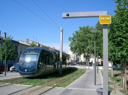

In [48]:
i = 0

os.makedirs('images', exist_ok=True)
dest = Path('/content/images/') / ims[i].split('/')[-1]
download_url(ims[i], dest)
im = Image.open(dest)
im.to_thumb(128,128)

In [49]:
# tram_types = ['prague', 'brussels', 'vienna', 'bordeaux']
tram_types = ['bordeaux']
path = Path('trams')

In [51]:
if not path.exists():
    path.mkdir()
for o in tram_types:
    dest = (path/o)
    dest.mkdir(exist_ok=True)
    results = search_images_bing(key, f'{o} trams')
    download_images(dest, urls=results.attrgot('content_url'))

bordeaux


Our folder has image files, as we'd expect:

In [55]:
fns = get_image_files(path)
fns

(#589) [Path('trams/vienna/00000004.jpg'),Path('trams/vienna/00000098.jpg'),Path('trams/vienna/00000133.jpeg'),Path('trams/vienna/00000146.jpg'),Path('trams/vienna/00000129.jpg'),Path('trams/vienna/00000025.jpg'),Path('trams/vienna/00000136.jpg'),Path('trams/vienna/00000046.jpg'),Path('trams/vienna/00000014.jpg'),Path('trams/vienna/00000107.jpg')...]

Often when we download files from the internet, there are a few that are corrupt. Let's check:

In [53]:
failed = verify_images(fns)
failed

(#3) [Path('trams/bordeaux/00000133.jpg'),Path('trams/bordeaux/00000077.jpg'),Path('trams/bordeaux/00000029.jpg')]

To remove all the failed images, you can use `unlink` on each of them. Note that, like most fastai functions that return a collection, `verify_images` returns an object of type `L`, which includes the `map` method. This calls the passed function on each element of the collection:

In [54]:
failed.map(Path.unlink);

## From Data to DataLoaders

In [76]:
trams = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128))

In [77]:
dls = trams.dataloaders(path)

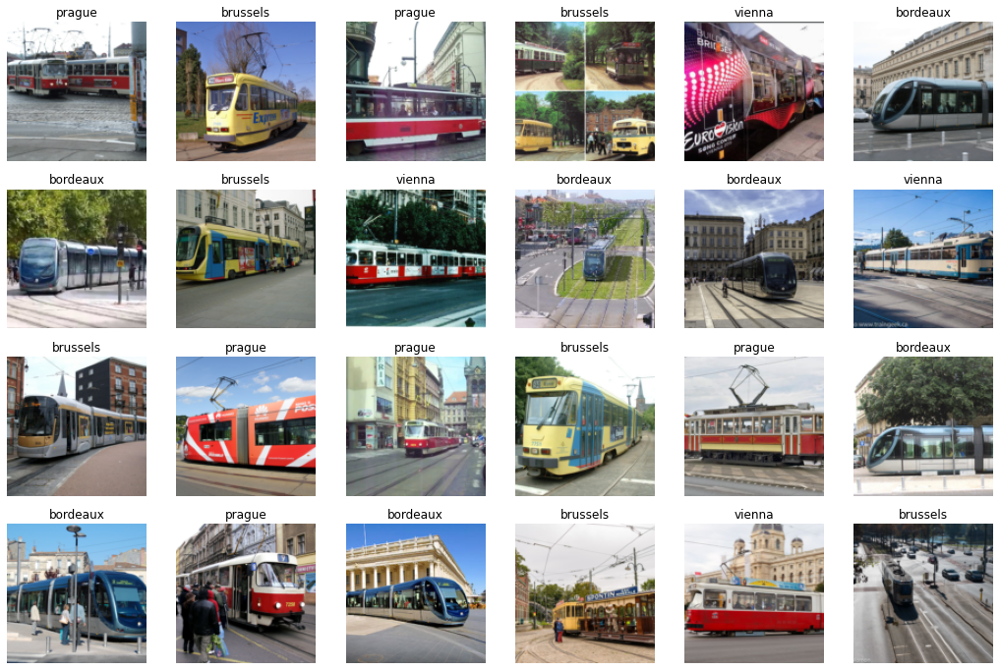

In [78]:
dls.valid.show_batch(max_n=24, nrows=4)

## Training Your Model, and Using It to Clean Your Data

Time to use the same lines of code as in <<chapter_intro>> to train our bear classifier.

We don't have a lot of data for our problem (150 pictures of each sort of bear at most), so to train our model, we'll use `RandomResizedCrop` with an image size of 224 px, which is fairly standard for image classification, and default `aug_transforms`:

In [79]:
trams = trams.new(
    item_tfms=RandomResizedCrop(224, min_scale=0.5),
    batch_tfms=aug_transforms())
dls = trams.dataloaders(path)

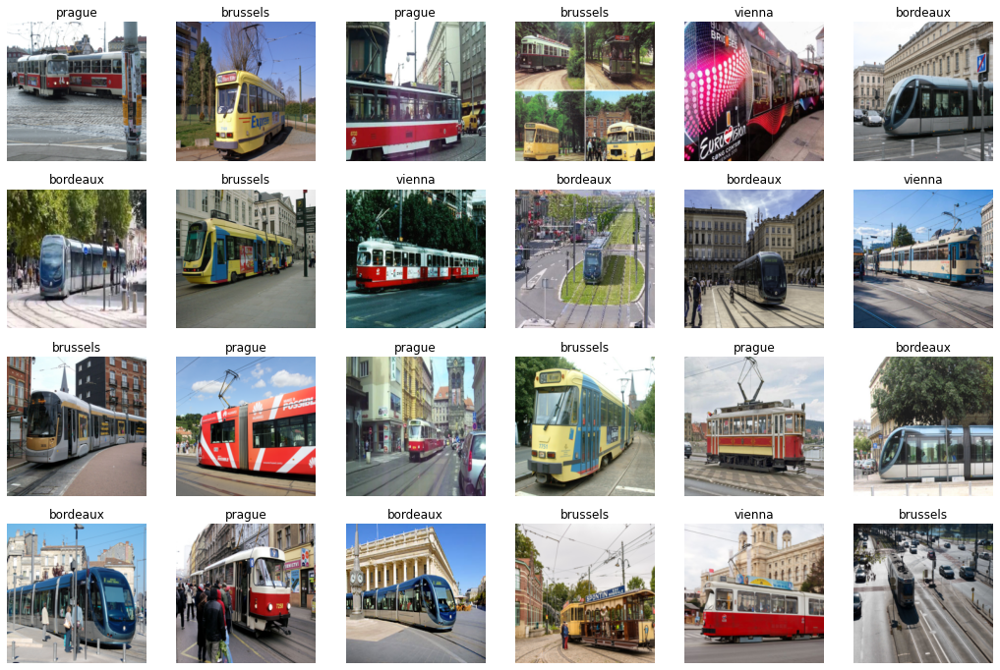

In [80]:
dls.valid.show_batch(max_n=24, nrows=4)

We can now create our `Learner` and fine-tune it in the usual way:

In [81]:
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(8)

epoch,train_loss,valid_loss,error_rate,time
0,2.245704,1.000631,0.424528,00:14


epoch,train_loss,valid_loss,error_rate,time
0,1.307639,0.842248,0.311321,00:14
1,1.146622,0.645352,0.216981,00:14
2,0.999062,0.472013,0.141509,00:14
3,0.820867,0.473117,0.113208,00:14
4,0.673735,0.450860,0.094340,00:13
5,0.573669,0.410561,0.094340,00:14
6,0.490387,0.408127,0.094340,00:14
7,0.436144,0.401295,0.094340,00:14


Now let's see whether the mistakes the model is making are mainly thinking that grizzlies are teddies (that would be bad for safety!), or that grizzlies are black bears, or something else. To visualize this, we can create a *confusion matrix*:

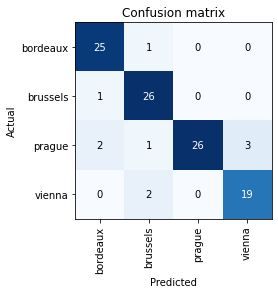

In [82]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

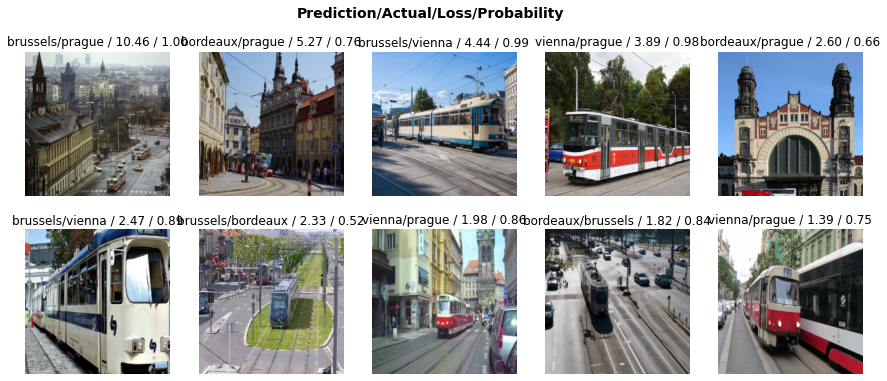

In [83]:
interp.plot_top_losses(10, nrows=2)

In [67]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [75]:
#hide
# Run this code for each selection above. In this case, once for each cat and once for train and valid
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

### Using the Model for Inference

In [84]:
learn.export()

In [85]:
path = Path()
path.ls(file_exts='.pkl')

(#1) [Path('export.pkl')]

In [86]:
learn_inf = load_learner(path/'export.pkl')

When we're doing inference, we're generally just getting predictions for one image at a time. To do this, pass a filename to `predict`:

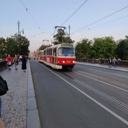

('prague', tensor(2), tensor([6.7427e-05, 5.1212e-05, 7.4925e-01, 2.5063e-01]))

In [93]:
dest = 'trams-new/007.jpg'
im = Image.open(dest)
display(im.to_thumb(128,128))
learn_inf.predict(dest)

This has returned three things: the predicted category in the same format you originally provided (in this case that's a string), the index of the predicted category, and the probabilities of each category. The last two are based on the order of categories in the *vocab* of the `DataLoaders`; that is, the stored list of all possible categories. At inference time, you can access the `DataLoaders` as an attribute of the `Learner`:

In [94]:
learn_inf.dls.vocab

(#4) ['bordeaux','brussels','prague','vienna']

### Creating a Notebook App from the Model

In [95]:
btn_upload = widgets.FileUpload()
btn_upload

FileUpload(value={}, description='Upload')

In [98]:
img = PILImage.create(btn_upload.data[-1])

out_pl = widgets.Output()
out_pl.clear_output()
with out_pl: display(img.to_thumb(128,128))
out_pl

Output()

In [99]:
pred, pred_idx, probs = learn_inf.predict(img)

and use a `Label` to display them:

In [100]:
lbl_pred = widgets.Label()
lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'
lbl_pred

Label(value='Prediction: prague; Probability: 0.9859')

We'll need a button to do the classification. It looks exactly like the upload button:

In [101]:
btn_run = widgets.Button(description='Classify')
btn_run

Button(description='Classify', style=ButtonStyle())

We'll also need a *click event handler*; that is, a function that will be called when it's pressed. We can just copy over the lines of code from above:

In [102]:
def on_click_classify(change):
    img = PILImage.create(btn_upload.data[-1])
    out_pl.clear_output()
    with out_pl: display(img.to_thumb(128,128))
    pred,pred_idx,probs = learn_inf.predict(img)
    lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'

btn_run.on_click(on_click_classify)

You can test the button now by pressing it, and you should see the image and predictions update automatically!

We can now put them all in a vertical box (`VBox`) to complete our GUI:

In [103]:
#hide
#Putting back btn_upload to a widget for next cell
btn_upload = widgets.FileUpload()

In [104]:
#hide_output
VBox([widgets.Label('Select your bear!'), 
      btn_upload, btn_run, out_pl, lbl_pred])